# Solarlog Data Analyse
This Kernal shows how to connect to Impala in order to load data directly from HAL PROD or STAG.

It takes about 2 min to run the whole notebook.

## Import

More information about impyla see here: https://github.com/cloudera/impyla.

In [1]:
from impala.dbapi import connect 
from impala.util import as_pandas
import pandas as pd # For Data Handling
import numpy as np  # data processing, CSV file I/O (e.g. pd.read_csv)
import math as mt
import datetime as dt # To convert timestamp data
import matplotlib   #for plots
import matplotlib.pyplot as plt
import seaborn as sns

sns.set(color_codes=True)
matplotlib.style.use('ggplot')
%matplotlib inline

## Load Data from HDFS with Impala

Die folgende querry benötigt 91s

In [2]:
conn = connect(host='172.16.10.102', port=21050)
cur = conn.cursor()
cur.execute('refresh solarlog_roh')
cur.execute('SELECT `timestamp`,cur_yield_watt,plantname FROM solarlog_roh order by `timestamp` limit 150000')
dfp = as_pandas(cur)
cur.close()
conn.close()
dfp.head()

,timestamp,cur_yield_watt,plantname
0,1513957635,0,
1,1513957665,0,
2,1513957801,0,
3,1513958101,0,
4,1513958402,0,


In [3]:
len(dfp)

111125

In [4]:
dfp.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 111125 entries, 0 to 111124
Data columns (total 3 columns):
timestamp         111125 non-null int64
cur_yield_watt    111125 non-null int64
plantname         111125 non-null object
dtypes: int64(2), object(1)
memory usage: 2.1+ MB


In [5]:
dfp.describe()

,timestamp,cur_yield_watt
count,1.111250e+05,111125.000000
mean,1.518344e+09,1365.937053
std,1.949552e+06,4501.007504
min,1.513958e+09,0.000000
25%,1.516729e+09,0.000000
50%,1.518407e+09,0.000000
75%,1.520091e+09,708.000000
max,1.521391e+09,51928.000000


## Daten Verstehen

In [6]:
# Change epochtime from timestamp to date time
df = pd.DataFrame() # New Data Frame
# Convert to datetime and add 1h corret time shift by collecting data
df['datetime'] = dfp.timestamp.apply(dt.datetime.utcfromtimestamp) + pd.Timedelta(hours=1)
df.sort_values(['datetime'])
df['value_watt'] = dfp.cur_yield_watt
df['name'] = dfp.plantname
df.head()

,datetime,value_watt,name
0,2017-12-22 16:47:15,0,
1,2017-12-22 16:47:45,0,
2,2017-12-22 16:50:01,0,
3,2017-12-22 16:55:01,0,
4,2017-12-22 17:00:02,0,


In [7]:
df.name.value_counts()

Pfadiheim Baar                          20974
Winsun AG, Steg                         20951
Meyer Rolf, Baar                        20944
Himmelrichstrasse 1ab, Baar             18086
Betschart René, Steinhausen             18081
                                         3095
Maechler Paul, Allenwinden               2065
Loosmann Johannes, Hausen am Albis       2065
Haller Roman, Rifferswil                 2049
Zengaffinen Kurt, Steg                    176
Baumgartu AG, Haus A, Steg                176
Bregy Bernhard, Steg                      176
Imboden Beat,Steg                         176
Seiler René, Steg                         176
Garage Fryand AG, Steg                    176
Moser Robert,Steg                         176
Heinzen Matthias und Christine, Steg      176
Steiner Bernhard, Steg                    176
Zengaffinen Hans, Steg                    176
Johner Daniel, Steg                       176
Mathieu Jörg, Steg                        176
Bregy Haustechnik AG, Steg        

In [8]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 111125 entries, 0 to 111124
Data columns (total 3 columns):
datetime      111125 non-null datetime64[ns]
value_watt    111125 non-null int64
name          111125 non-null object
dtypes: datetime64[ns](1), int64(1), object(1)
memory usage: 2.1+ MB


In [9]:
df.groupby('name').describe().value_watt
dfp1 = df.copy()

In [10]:
df1 = dfp1[dfp1['name'] == 'Pfadiheim Baar']
df2 = dfp1[dfp1['name'] == 'Meyer Rolf, Baar']
df3 = dfp1[dfp1['name'] == 'Winsun AG, Steg']
df4 = dfp1[dfp1['name'] == 'Himmelrichstrasse 1ab, Baar']
df5 = dfp1[dfp1['name'] == 'Betschart René, Steinhausen']
df6 = dfp1[dfp1['name'] == 'Loosmann Johannes, Hausen am Albis']
df7 = dfp1[dfp1['name'] == 'Haller Roman, Rifferswil']
#df8 = dfp1[dfp1['name'] == 'Maechler Paul, Allenwinden']

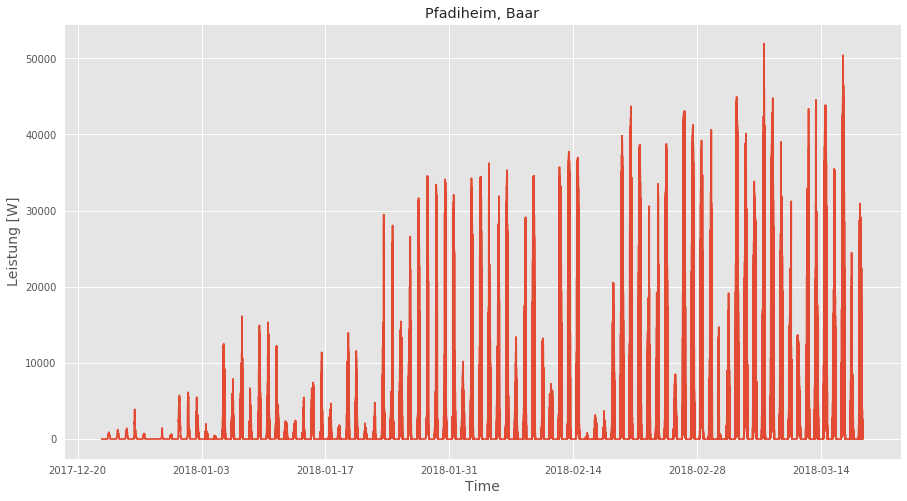

In [11]:
# Time Series Plot
plt.figure(figsize = (15,8))
plt.plot(dfp1.datetime,dfp1.value_watt)
plt.ylabel("Leistung [W]",size=14)
plt.xlabel("Time",size=14)
plt.title("Pfadiheim, Baar")
plt.show()

In [12]:
import plotly
from plotly.offline import download_plotlyjs, init_notebook_mode, plot, iplot
from plotly.graph_objs import *
init_notebook_mode(connected=True) #need to use plotly offline

data = Data([Scatter(x=df1.datetime, y=df1.value_watt, name='Pfadiheim Baar'),
             Scatter(x=df2.datetime, y=df2.value_watt, name='Meyer Rolf, Baar'),
             Scatter(x=df3.datetime, y=df3.value_watt, name='Winsun AG, Steg'),
             Scatter(x=df4.datetime, y=df4.value_watt, name='Himmelrichstrasse 1ab, Baar'),
             Scatter(x=df5.datetime, y=df5.value_watt, name='Betschart René, Steinhausen'),
             Scatter(x=df6.datetime, y=df6.value_watt, name='Loosmann Johannes, Hausen am Albis'),
             Scatter(x=df7.datetime, y=df7.value_watt, name='Haller Roman, Rifferswil')])

layout = Layout(
    title='Leistung aller Anlagen',
    yaxis=dict(title='Leistung in [kW]'),
    xaxis=dict(title='Zeit')
)

fig = Figure(data=data, layout=layout)

iplot(fig, filename = 'basic-line')

## Lade Solar Inventar Tabelle
Die Daten der Winsun Anlage in der inverntar_solar Tabelle werden direkt über die Solarlog API in HDFS konsumiert.

In [13]:
conn = connect(host='172.16.10.102', port=21050)
cur = conn.cursor()
cur.execute('refresh inventory_solar')
cur.execute('SELECT * FROM inventory_solar')
dfis = as_pandas(cur)
cur.close()
conn.close()
#To see all tables tip only dfp without .head()
dfis.head(1)

,index,anlagenleistung,ausrichtung,id,neigung,plantname,zip
0,0,12.72,22°,51769,14°,Pfadiheim Baar,CH - 6340 Baar


In [14]:
df = dfis.set_index('index')
df['nennleistung'] = df.anlagenleistung
df['name'] = df.plantname
df['ort'] = df.zip
df.drop('anlagenleistung', axis=1, inplace=True)
df.drop('plantname', axis=1, inplace=True)
df.drop('zip', axis=1, inplace=True)
df

,ausrichtung,id,neigung,nennleistung,name,ort
index,,,,,,
0,22°,51769,14°,12.72,Pfadiheim Baar,CH - 6340 Baar
1,-13°,26678,6°,60.00,"Winsun AG, Steg",CH - 3940 Steg
2,-43°,54349,5°,12.00,"Meyer Rolf, Baar",CH - 6340 Baar
3,-55°,48542,13°,18.60,"Himmelrichstrasse 1ab, Baar",CH - 6340 Baar
4,-37°,55610,5°,12.00,"Betschart René, Steinhausen",CH - 6312 Steinhausen
5,-33°,58209,30°,10.00,"Maechler Paul, Allenwinden",CH - 6319 Allenwinden
6,-70°,52738,39°,23.49,"Haller Roman, Rifferswil",CH - 8911 Rifferswil
7,-47°,55610,14°,5.50,"Loosmann Johannes, Hausen am Albis",CH - 8915 Hausen am Albis


## Vergleich der Anlagen

In [15]:
df[df.name == 'Pfadiheim Baar'].nennleistung*1000

index
0    12720.0
Name: nennleistung, dtype: float64

In [16]:
dfp1[dfp1.name=='Pfadiheim Baar'].value_watt.head()

3095    1162
3096    1162
3097     632
3098     632
3099     632
Name: value_watt, dtype: int64

In [17]:
len(dfp1[dfp1.name=='Pfadiheim Baar'].value_watt/(int(df[df.name == 'Pfadiheim Baar'].nennleistung)))

20974

In [18]:
# Um die Anlagen Vergelichbar zu machen wird nun der spezifische Ertrag berechnet
dfp1['spez_leistung'] = dfp1.value_watt
dfp1.loc[dfp1[dfp1.name=='Pfadiheim Baar'].index,"spez_leistung"] = dfp1[dfp1.name=='Pfadiheim Baar'].value_watt/(int(df[df.name == 'Pfadiheim Baar'].nennleistung*1000))
dfp1.loc[dfp1[dfp1.name=='Winsun AG, Steg'].index,"spez_leistung"] = dfp1[dfp1.name=='Winsun AG, Steg'].value_watt/(int(df[df.name == 'Winsun AG, Steg'].nennleistung*1000))
dfp1.loc[dfp1[dfp1.name=='Meyer Rolf, Baar'].index,"spez_leistung"]= dfp1[dfp1.name=='Meyer Rolf, Baar'].value_watt/(int(df[df.name == 'Meyer Rolf, Baar'].nennleistung*1000))
dfp1.loc[dfp1[dfp1.name=='Himmelrichstrasse 1ab, Baar'].index,"spez_leistung"]= dfp1[dfp1.name=='Himmelrichstrasse 1ab, Baar'].value_watt/(int(df[df.name == 'Himmelrichstrasse 1ab, Baar'].nennleistung*1000))
dfp1.loc[dfp1[dfp1.name=='Betschart René, Steinhausen'].index,"spez_leistung"]= dfp1[dfp1.name=='Betschart René, Steinhausen'].value_watt/(int(df[df.name == 'Betschart René, Steinhausen'].nennleistung*1000))
dfp1.loc[dfp1[dfp1.name=='Loosmann Johannes, Hausen am Albis'].index,"spez_leistung"]= dfp1[dfp1.name=='Loosmann Johannes, Hausen am Albis'].value_watt/(int(df[df.name == 'Loosmann Johannes, Hausen am Albis'].nennleistung*1000))
dfp1.loc[dfp1[dfp1.name=='Haller Roman, Rifferswil'].index,"spez_leistung"]= dfp1[dfp1.name=='Haller Roman, Rifferswil'].value_watt/(int(df[df.name == 'Haller Roman, Rifferswil'].nennleistung*1000))
dfp1.head()                                                   

,datetime,value_watt,name,spez_leistung
0,2017-12-22 16:47:15,0,,0.0
1,2017-12-22 16:47:45,0,,0.0
2,2017-12-22 16:50:01,0,,0.0
3,2017-12-22 16:55:01,0,,0.0
4,2017-12-22 17:00:02,0,,0.0


In [19]:
dfp1[dfp1.name=='Himmelrichstrasse 1ab, Baar'].head()

,datetime,value_watt,name,spez_leistung
11705,2018-01-12 13:20:01,610,"Himmelrichstrasse 1ab, Baar",0.032796
11710,2018-01-12 13:25:02,491,"Himmelrichstrasse 1ab, Baar",0.026398
11713,2018-01-12 13:30:02,491,"Himmelrichstrasse 1ab, Baar",0.026398
11721,2018-01-12 13:35:02,465,"Himmelrichstrasse 1ab, Baar",0.025000
11723,2018-01-12 13:40:01,465,"Himmelrichstrasse 1ab, Baar",0.025000


In [20]:
dfp1.fillna(0)
dfp1.describe()

,value_watt,spez_leistung
count,111125.000000,111125.000000
mean,1365.937053,64.866451
std,4501.007504,663.647457
min,0.000000,0.000000
25%,0.000000,0.000000
50%,0.000000,0.000000
75%,708.000000,0.051258
max,51928.000000,26407.000000


In [21]:
data2 = Data([Scatter(x=dfp1[dfp1.name == 'Pfadiheim Baar'].datetime, y=dfp1[dfp1.name == 'Pfadiheim Baar'].spez_leistung, name='Pfadiheim, Baar'),
             Scatter(x=dfp1[dfp1.name == 'Meyer Rolf, Baar'].datetime, y=dfp1[dfp1.name == 'Meyer Rolf, Baar'].spez_leistung, name='Meyer, Baar'),
             Scatter(x=dfp1[dfp1.name == 'Betschart René, Steinhausen'].datetime, y=dfp1[dfp1.name == 'Betschart René, Steinhausen'].spez_leistung, name='Betschart, Steinhausen'),
             Scatter(x=dfp1[dfp1.name == 'Himmelrichstrasse 1ab, Baar'].datetime, y=dfp1[dfp1.name == 'Himmelrichstrasse 1ab, Baar'].spez_leistung, name='Himmelrichstrasse, Baar'),
             Scatter(x=dfp1[dfp1.name == 'Loosmann Johannes, Hausen am Albis'].datetime, y=dfp1[dfp1.name == 'Loosmann Johannes, Hausen am Albis'].spez_leistung, name='Loosmann, Hausen am Albis'),
             Scatter(x=dfp1[dfp1.name == 'Haller Roman, Rifferswil'].datetime, y=dfp1[dfp1.name == 'Haller Roman, Rifferswil'].spez_leistung, name='Haller Rifferswil'),
             Scatter(x=dfp1[dfp1.name == 'Winsun AG, Steg'].datetime, y=dfp1[dfp1.name == 'Winsun AG, Steg'].spez_leistung, name='Winsun AG, Steg')])

layout2 = Layout(
    title='Spezifische Leistung aller Anlagen',
    yaxis=dict(title='Spezifische Leistung [kW/kWp]'),
    xaxis=dict(title='Zeit')
)

fig2 = Figure(data=data2, layout=layout2)

iplot(fig2, filename = 'basic-line')

In [22]:
#Zeit Beschränkung
today = dt.date.today()
week_ago = today - dt.timedelta(days=30)
dfpt = dfp1[dfp1.datetime > week_ago]
#Prepare Plot
data2 = Data([Scatter(x=dfpt[dfpt.name == 'Pfadiheim Baar'].datetime, y=dfpt[dfpt.name == 'Pfadiheim Baar'].spez_leistung, name='Pfadiheim, Baar'),
             Scatter(x=dfpt[dfpt.name == 'Meyer Rolf, Baar'].datetime, y=dfpt[dfpt.name == 'Meyer Rolf, Baar'].spez_leistung, name='Meyer, Baar'),
             Scatter(x=dfpt[dfpt.name == 'Betschart René, Steinhausen'].datetime, y=dfpt[dfpt.name == 'Betschart René, Steinhausen'].spez_leistung, name='Betschart, Steinhausen'),
             Scatter(x=dfpt[dfpt.name == 'Himmelrichstrasse 1ab, Baar'].datetime, y=dfpt[dfpt.name == 'Himmelrichstrasse 1ab, Baar'].spez_leistung, name='Himmelrichstrasse, Baar'),
             Scatter(x=dfpt[dfpt.name == 'Loosmann Johannes, Hausen am Albis'].datetime, y=dfpt[dfpt.name == 'Loosmann Johannes, Hausen am Albis'].spez_leistung, name='Loosmann, Hausen am Albis'),
             Scatter(x=dfpt[dfpt.name == 'Haller Roman, Rifferswil'].datetime, y=dfpt[dfpt.name == 'Haller Roman, Rifferswil'].spez_leistung, name='Haller Rifferswil'),
             Scatter(x=dfpt[dfpt.name == 'Winsun AG, Steg'].datetime, y=dfpt[dfpt.name == 'Winsun AG, Steg'].spez_leistung, name='Winsun AG, Steg')])

layout2 = Layout(
    title='Spezifische Leistung aller Anlagen',
    yaxis=dict(title='Spezifische Leistung [kW/kWp]'),
    xaxis=dict(title='Zeit')
)

fig2 = Figure(data=data2, layout=layout2)

iplot(fig2, filename = 'basic-line')

In [23]:
dfsp = pd.DataFrame(index=dfp1.datetime)
#df3 = pd.DataFrame(df2['teams'].values.tolist(), columns=['team1','team2'])
dfsp = pd.DataFrame(dfsp['name'].,colums=['']

dfsp['Pfadiheim Baar'] = dfp1[dfp1.name == 'Pfadiheim Baar'].spez_leistung.value
dfsp['Meyer Rolf, Baar'] = dfp1[dfp1.name == 'Meyer Rolf, Baar'].spez_leistung
dfsp.head()

SyntaxError: invalid syntax (<ipython-input-23-37cf5d60b503>, line 3)

In [ ]:
dfsp.corr()